In [34]:
# Import required libraries
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import CountVectorizer, ENGLISH_STOP_WORDS
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN

import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
# Reload cleaned search results data if needed 
file_path = './output/searchresults-cleaned.csv'
df = pd.read_csv(file_path, lineterminator='\n')

## Build a topic model 

In [16]:
# Define custom stopwords and initialize CountVectorizer
custom_stopwords = ["figure", "fig","doi","https","org","disease","clinical","study","www"]
with open('./output/pubmed.txt', 'r') as file:
    pubmed_stopwords = file.readlines()
    # Remove newline characters
    values = [line.strip() for line in pubmed_stopwords]
all_stopwords = list(ENGLISH_STOP_WORDS.union(custom_stopwords).union(pubmed_stopwords)) 

vectorizer_model = CountVectorizer(
    stop_words=all_stopwords,
    min_df=5  # Only include words that appear in at least 5 documents
)

# Initialize Sentence-BERT model for embeddings
embedding_model = SentenceTransformer('all-MiniLM-L6-v2')

# Instantiate UMAP and HDBSCAN with desired parameters
# Ensure these are NOT dictionaries
umap_model = UMAP(n_neighbors=10, n_components=15, metric='cosine')
hdbscan_model = HDBSCAN(min_cluster_size=15, min_samples=15, metric='euclidean')

# Initialize BERTopic with more words per topic
topic_model = BERTopic(
    embedding_model=embedding_model,
    vectorizer_model=vectorizer_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    top_n_words=15,  # The number of words to retrieve per topic
    verbose=False #,
    #nr_topics="auto"
)


# Fit the model
# Combine "PaperTitle" and "Abstract" columns for topic modeling
docs = df["PaperTitle"].fillna('') + " " + df["Abstract"].fillna('')

topics, probabilities = topic_model.fit_transform(docs)

# View the number of topics identified
print("Number of topics identified:", len(topic_model.get_topic_info()) - 1)  # Exclude -1 for outliers


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

Number of topics identified: 973


In [17]:

# Get topic information
topics_info = topic_model.get_topic_info()

# Print each topic with only the words (no scores)
for topic_num in topics_info.Topic:
    if topic_num != -1:  # Exclude the outlier topic
        topic_words = [word for word, _ in topic_model.get_topic(topic_num)]  # Extract only words
        print(f"Topic {topic_num}: {', '.join(topic_words)}")



Topic 0: alcohol, opioid, substance, drinking, use, dependence, aud, methamphetamine, addiction, opioids, drug, sud, buprenorphine, misuse, oud
Topic 1: gut, microbiota, microbiome, probiotics, axis, intestinal, microbial, probiotic, dysbiosis, bacteria, composition, fecal, metabolites, bacterial, mice
Topic 2: hiv, aids, antiretroviral, living, art, plwh, plhiv, msm, infected, stigma, adherence, prep, viral, plwha, pwh
Topic 3: suicide, suicidal, ideation, attempts, nssi, attempt, harm, suicidality, si, attempted, risk, attempters, prevention, suicides, thoughts
Topic 4: autism, asd, autistic, spectrum, children, sensory, parents, traits, camouflaging, intellectual, parent, child, adults, difficulties, asc
Topic 5: extract, kg, herbal, plants, plant, mg, antidepressant, medicinal, anxiolytic, mice, rats, antioxidant, extracts, cums, anti
Topic 6: tbi, concussion, injury, mtbi, traumatic, veterans, mild, concussions, brain, football, concussive, abi, head, athletes, pcs
Topic 7: hemodi

In [18]:
topic_model.visualize_topics()

In [19]:
topic_model.visualize_hierarchy()

## Use a language model to generate meaningful topic names

In [8]:
# Use a language model to generate topic names 

from transformers import AutoTokenizer, AutoModelForCausalLM
from transformers import pipeline
from openai import OpenAI

SYSTEM_MSG = "You are a helpful expert assistant for working with topics from the scientific literature in the field of mental health."

modelname = "meta-llama/Llama-3.3-70B-Instruct"

client = OpenAI(
        api_key = "INSERT YOUR API KEY HERE",
        base_url="https://api.deepinfra.com/v1/openai",
)
def generateFromPrompt(promptStr,maxTokens=100):
    messages=[
        {"role": "system", "content": SYSTEM_MSG},
        {"role": "user", "content": promptStr}
    ]
    completion = client.chat.completions.create(
    model=modelname,
    messages=messages)
    response=completion.choices[0].message.content
    return(response)

generateFromPrompt("Hello!")

"Hello! I'm delighted to help you navigate the vast and fascinating field of mental health. Are you looking for information on a specific topic, such as anxiety, depression, or trauma? Or perhaps you're interested in exploring the latest research and developments in the field? I'm here to provide you with accurate and reliable information, so please feel free to ask me anything!"

In [20]:
# Generate topic names
topic_names = []
topic_nums = []
topic_wordlists = []

for topic_num in topics_info.Topic:
    if topic_num != -1:  # Exclude the outlier topic
        topic_words = [word for word, _ in topic_model.get_topic(topic_num)]  # Extract only words
        topic_nums.append(topic_num)
        topic_names.append(generateFromPrompt(f"Please give a concise word or phrase to describe the main topic that unifies the following words: {topic_words}. Please return only the word or phrase with no explanation. Topic: "))
        topic_wordlists.append(",".join(topic_words))

In [21]:
output_dir = "./output"
df_topics = pd.DataFrame({"Topic":topic_nums,"Name":topic_names,"Words":topic_wordlists})
output_file_path = os.path.join(output_dir, 'topics.csv')
df_topics.to_csv(output_file_path, index=False)
df_topics

,Topic,Name,Words
0,0,Substance Use Disorder,"alcohol,opioid,substance,drinking,use,dependen..."
1,1,Gut-Brain Axis,"gut,microbiota,microbiome,probiotics,axis,inte..."
2,2,HIV/AIDS Management,"hiv,aids,antiretroviral,living,art,plwh,plhiv,..."
3,3,Suicidal behavior,"suicide,suicidal,ideation,attempts,nssi,attemp..."
4,4,Autism Spectrum Disorder,"autism,asd,autistic,spectrum,children,sensory,..."
...,...,...,...
968,968,Iron homeostasis and neurodegeneration,"iron,ferroptosis,lcn2,overload,labile,tbi,nrf2..."
969,969,Spinal pain management,"epidural,radicular,herniation,steroid,osteocho..."
970,970,Genetic Variants,"cnvs,variants,deletion,schizophrenia,deletions..."
971,971,Child Exposure to Domestic Violence,"domestic,violence,dv,children,exposed,actualiz..."


## Detect topic mentions in articles with a topic distribution model

In [22]:
topic_distr, _ = topic_model.approximate_distribution(docs)


In [23]:
# Sanity checks and threshold assignment

print(docs[0])
topic_model.visualize_distribution(topic_distr[0])

Measuring Anxiety Levels with Head Motion Patterns in Severe Depression Population Depression and anxiety are prevalent mental health disorders that frequently cooccur, with anxiety significantly influencing both the manifestation and treatment of depression. An accurate assessment of anxiety levels in individuals with depression is crucial to develop effective and personalized treatment plans. This study proposes a new noninvasive method for quantifying anxiety severity by analyzing head movements -specifically speed, acceleration, and angular displacement - during video-recorded interviews with patients suffering from severe depression. Using data from a new CALYPSO Depression Dataset, we extracted head motion characteristics and applied regression analysis to predict clinically evaluated anxiety levels. Our results demonstrate a high level of precision, achieving a mean absolute error (MAE) of 0.35 in predicting the severity of psychological anxiety based on head movement patterns. 

In [24]:
print(docs[5])
topic_model.visualize_distribution(topic_distr[5])

Efficacy of a CBT Self-Help App (Zemedy) Versus an Education, Relaxation, and Mindfulness App for IBS Goals: To test the efficacy of a self-help cognitive behavioral therapy (CBT) for irritable bowel syndrome (IBS) app compared with an active control app. Background: IBS is a disorder of gut-brain interaction that can result in significant distress, disability, and psychiatric co-morbidity. CBT is an effective treatment for IBS. Self-help CBT apps can increase accessibility but should be tested against active controls. Methods: This randomized controlled trial (NCT04665271) compared a CBT for IBS self-help app (Zemedy) to an active education, lifestyle management, relaxation, and mindfulness control app. A total of 453 individuals were screened in and offered allocation to treatment. Participants who actually downloaded their assigned app (N=267) were evenly split between the CBT app (N=136) and the active control (N=131). Follow-up data (CBT N=74, control N=82) were collected immediat

In [25]:
print(docs[3])
topic_model.visualize_distribution(topic_distr[3])

AI-Driven Emotion Recognition Meets EEG for Next-Generation Mental Well-Being Purpose: The paper addresses the increasing prevalence of mental health challenges, such as stress, anxiety, and depression, highlighting the need for innovative solutions that integrate technology with personalized therapy. It aims to develop a system that provides real-time, individualized mental health support, addressing gaps in traditional therapeutic approaches. Method: The system integrates emotion recognition technology and adaptive therapeutic interventions using EEG signal processing combined with a Linear Discriminant Analysis (LDA) classification model for real-time emotion recognition. It can also be applied in brain-computer interface (BCI) research for emotion classification. Finding: Experimental results and user studies demonstrate the system's potential to improve emotional well-being through tailored, context-aware interventions. Conclusion: The model, which leverages advanced emotion analy

In [28]:
# Get a binary matrix of documents per topic
topic_distr_binary = topic_distr.copy()


max_indices = topic_distr_binary.argmax(axis=1)

topic_distr_binary[np.arange(len(topic_distr_binary)), max_indices] = 1


THRESHOLD = 0.08 

topic_distr_binary = (topic_distr_binary > THRESHOLD).astype(int)

topic_distr_binary

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [29]:
output_dir = "./output"
binary_df = df.iloc[:, : 9]

new_columns = [f'Topic{i}' for i in range(topic_distr_binary.shape[1])]
binary_df = pd.concat([binary_df, pd.DataFrame(topic_distr_binary,columns=new_columns)], axis=1)


In [30]:
# Convert 'PubDate' to datetime
binary_df['PubDate'] = pd.to_datetime(binary_df['PubDate'], errors='coerce')

# Drop any rows where PubDate is NaT (invalid dates)
binary_df = binary_df.dropna(subset=['PubDate'])

# Save the binary matrix to a new CSV file
output_file_path = os.path.join(output_dir, 'binary_matrix.csv')
binary_df.to_csv(output_file_path, index=False)

# Preview the updated dataframe
binary_df

,PaperId,PaperTitle,Citations,coFoS,Authors,Abstract,Lang,PubYear,PubDate,Topic0,...,Topic963,Topic964,Topic965,Topic966,Topic967,Topic968,Topic969,Topic970,Topic971,Topic972
0,4407571063,Measuring Anxiety Levels with Head Motion Patt...,NaN,558461103|2776867660|107551265|70410870|290864...,"Fouad Boualeb, Emery Pierson, Nicolas Doudeau,...",Depression and anxiety are prevalent mental he...,en,2025,2025-05-26,0,...,0,0,0,0,0,0,0,0,0,0
1,4408348922,Currents of change,NaN,39432304,Dore Loef,Introduction Depression is one of the most com...,en,2025,2025-03-13,0,...,0,0,0,0,0,0,0,0,0,0
2,4408311072,Prevalence and determinants of depression and ...,1972772384|1983609344|2013263319|2106355267|21...,2776867660|142853389|143998085|2778087770|2776...,"Sameer A. Alkubati, Abdulsalam Halboup, Mohame...",Early detection of depression in cancer patien...,en,2025,2025-03-12,0,...,0,0,0,0,0,0,0,0,0,0
3,4408317156,AI-Driven Emotion Recognition Meets EEG for Ne...,NaN,522805319|2777438025|15744967|41008148|2849031...,"Jyoti Mudkanna Gavhane, Gayatri Shirke, Subodh...",Purpose: The paper addresses the increasing pr...,en,2025,2025-03-12,0,...,0,0,0,0,0,0,0,0,0,0
4,4408342700,Effectiveness of Internet-based stress inocula...,1984398689|2041079317|2043925519|2048498566|20...,110875604|21036866|15744967|169900460|27772115...,"Shirin Shahrokhi, Zahra Basirat, Farzan Kheirk...",Introduction: Internet-based psychotherapies a...,en,2025,2025-03-12,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159945,901732029,Poweryogans effekt pa psykologisk halsa - En r...,NaN,2780444219|558461103|2780945536|15744967|17942...,Anna Ahlerup,The aim of this randomized controlled study wa...,en,2015,2015-01-01,0,...,0,0,0,0,0,0,0,0,0,0
159946,906898468,"""Jag rakar lida av psykisk ohalsa, men nej, ni...",NaN,2780600973|15744967|2779354729|168285401|12298...,"Olivia Lood, Camilla Sully",The purpose of this study is to shed light on ...,en,2015,2015-01-01,0,...,0,0,0,0,0,0,0,0,0,0
159947,934054867,Stigmatisering av psykiskt sjuka: Hur allmanhe...,NaN,2780224610|15744967|2776674806|2776035688|2779...,"Cecilia Johansson, Nina Borg",Stigmatization of mental illness leads to disc...,en,2015,2015-01-01,0,...,0,0,0,0,0,0,0,0,0,0
159948,941312019,Internetformedlad depressionsbehandling : En j...,NaN,2776867660|3020255362|15744967|100480397|18626...,Emma Sjöström,Depression is one of the most widespread disea...,en,2015,2015-01-01,0,...,0,0,0,0,0,0,0,0,0,0


0         1
1         4
2         1
3         4
4         1
         ..
159945    1
159946    1
159947    1
159948    2
159949    3
Length: 159950, dtype: int64

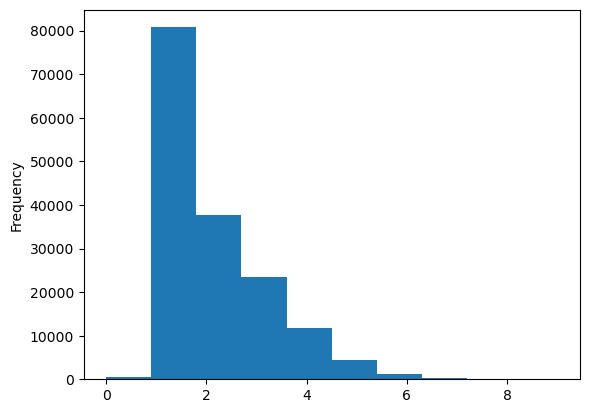

In [31]:
# How many topics are mentioned per paper? Ideally we want this to be not more than 2-3 but seldom 0

row_counts = binary_df.iloc[:, 10: ].sum(axis=1)
row_counts.plot(kind='hist')
row_counts

In [32]:
# Select only the numeric columns
numeric_columns = binary_df.select_dtypes(include='number').columns.tolist()

# Define non-topic columns to exclude
non_topic_columns = ['PaperId', 'PubDate', 'PubYear', 'Citations', 'Authors', 'Lang']  # Add any other non-topic columns here

# Filter out non-topic columns from numeric_columns
topic_columns = [col for col in numeric_columns if col not in non_topic_columns]

# Group by year and count mentions of each topic
yearly_mentions = binary_df.groupby(pd.Grouper(key='PubDate', freq='Y'))[topic_columns].sum()

# Calculate the total mentions per year
total_mentions_yearly = yearly_mentions.sum(axis=1)

# Calculate relative proportions for each topic by dividing by the total mentions in each year
proportions_yearly = yearly_mentions.divide(total_mentions_yearly, axis=0)

# Group by month-end ('ME') and count mentions of each topic
monthly_mentions = binary_df.groupby(pd.Grouper(key='PubDate', freq='M'))[topic_columns].sum()

# Calculate total mentions per month
total_mentions_monthly = monthly_mentions.sum(axis=1)

# Calculate relative proportions for each topic by dividing by the total mentions in each month
proportions_monthly = monthly_mentions.divide(total_mentions_monthly, axis=0)

# Group by week ('W') and count mentions of each topic
weekly_mentions = binary_df.groupby(pd.Grouper(key='PubDate', freq='W'))[topic_columns].sum()

# Calculate total mentions per week
total_mentions_weekly = weekly_mentions.sum(axis=1)

# Calculate relative proportions for each topic by dividing by the total mentions in each week
proportions_weekly = weekly_mentions.divide(total_mentions_weekly, axis=0)

# Preview the aggregated data
print("Yearly Mentions:\n", yearly_mentions.head())
print("Total Mentions Yearly:\n", total_mentions_yearly.head())
print("Proportions Yearly:\n", proportions_yearly.head())

print("Monthly Mentions:\n", monthly_mentions.head())
print("Total Mentions Monthly:\n", total_mentions_monthly.head())
print("Proportions Monthly:\n", proportions_monthly.head())

print("Weekly Mentions:\n", weekly_mentions.head())
print("Total Mentions Weekly:\n", total_mentions_weekly.head())
print("Proportions Weekly:\n", proportions_weekly.head())

# Export yearly mentions to a CSV file
output_file_path = os.path.join(output_dir, 'yearly_mentions.csv')
yearly_mentions.to_csv(output_file_path)

output_file_path = os.path.join(output_dir, 'total_yearly_mentions.csv')
total_mentions_yearly.to_csv(output_file_path)

# Export monthly mentions to a CSV file
output_file_path = os.path.join(output_dir, 'monthly_mentions.csv')
monthly_mentions.to_csv(output_file_path)

output_file_path = os.path.join(output_dir, 'total_monthly_mentions.csv')
total_mentions_monthly.to_csv(output_file_path)

# Export weekly mentions to a CSV file
output_file_path = os.path.join(output_dir, 'weekly_mentions.csv')
weekly_mentions.to_csv(output_file_path)

output_file_path = os.path.join(output_dir, 'total_weekly_mentions.csv')
total_mentions_weekly.to_csv(output_file_path)

Yearly Mentions:
             Topic0  Topic1  Topic2  Topic3  Topic4  Topic5  Topic6  Topic7  \
PubDate                                                                      
2015-12-31     123      21     111     152      86      46      82      53   
2016-12-31     148      36     123     155      72      55      82      50   
2017-12-31     156      53     149     144     108      59      88      55   
2018-12-31     134      76      97     161     123      60      79      70   
2019-12-31     159     110     141     151     107      61     114      72   

            Topic8  Topic9  ...  Topic963  Topic964  Topic965  Topic966  \
PubDate                     ...                                           
2015-12-31     115      72  ...         3        19        29        14   
2016-12-31     117      94  ...        10        27        28        11   
2017-12-31     113      79  ...         9        15        33        10   
2018-12-31     109      85  ...         5        15        2

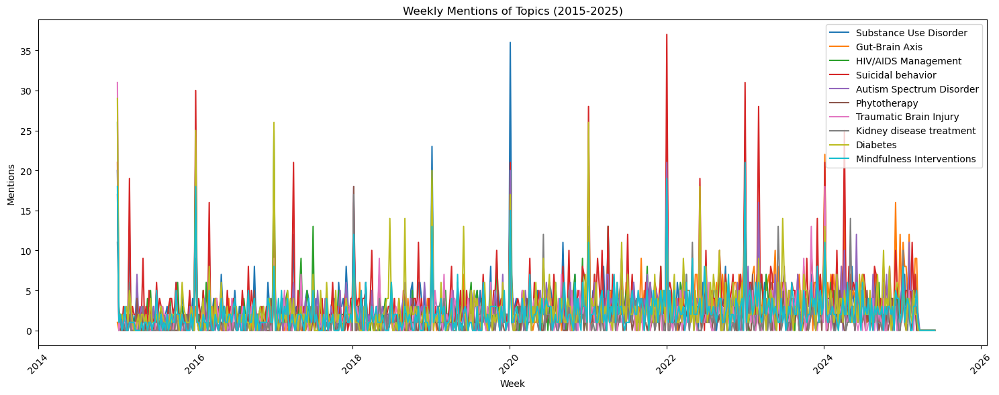

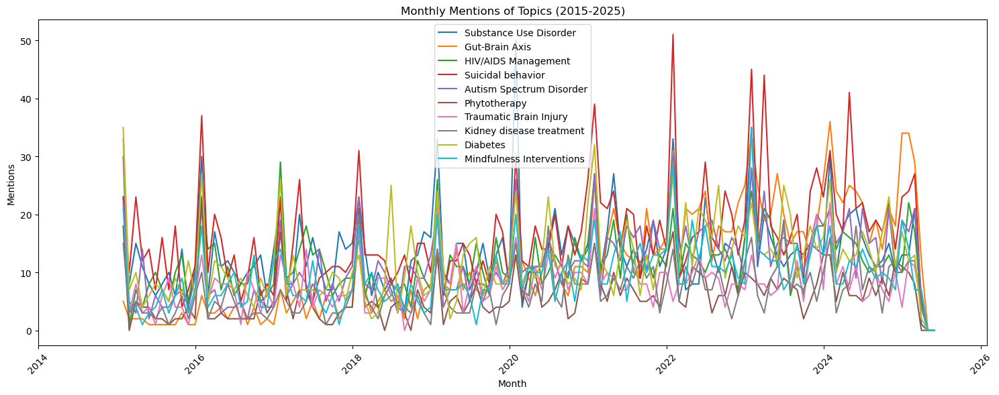

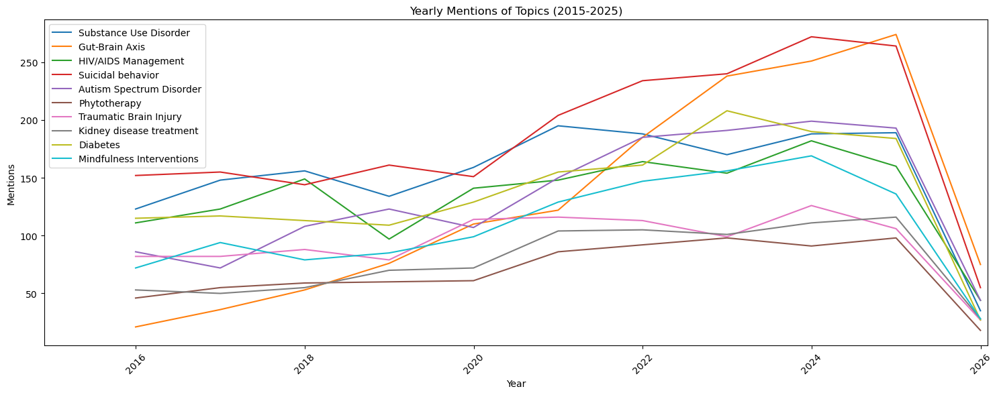

In [35]:
# Visualize weekly mentions
plt.figure(figsize=(15, 6))
for column in weekly_mentions.columns[0:10]:
    plt.plot(weekly_mentions.index, weekly_mentions[column], label=topic_names[int(column.replace("Topic",""))])
plt.title('Weekly Mentions of Topics (2015-2025)')
plt.xlabel('Week')
plt.ylabel('Mentions')
plt.xlim(pd.Timestamp('2014-01-01'), pd.Timestamp('2026-01-31'))
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


# Visualize monthly mentions from January 2014 to the current month
plt.figure(figsize=(15, 6))
for column in monthly_mentions.columns[0:10]:
    plt.plot(monthly_mentions.index, monthly_mentions[column], label=topic_names[int(column.replace("Topic",""))])
plt.title('Monthly Mentions of Topics (2015-2025)')
plt.xlabel('Month')
plt.ylabel('Mentions')
plt.xlim(pd.Timestamp('2014-01-01'), pd.Timestamp('2026-01-31'))
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


# Visualize yearly mentions from 2014 to the current year
plt.figure(figsize=(15, 6))
for column in yearly_mentions.columns[0:10]:
    plt.plot(yearly_mentions.index, yearly_mentions[column], label=topic_names[int(column.replace("Topic",""))])
plt.title('Yearly Mentions of Topics (2015-2025)')
plt.xlabel('Year')
plt.ylabel('Mentions')
plt.xlim(pd.Timestamp('2014-12-01'), pd.Timestamp('2026-01-31'))
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
# Reload binary dataframe
import os
import pandas as pd

output_file_path = os.path.join('./output', 'binary_matrix.csv')
binary_df = pd.read_csv(output_file_path)

In [37]:
binary_df.query("Topic65==1 and PubYear>2023")['PaperTitle'].values

array(['Prolonged Grief Disorder: A Narrative Review',
       'Effectiveness of Empower-Grief for relatives of palliative care patients: Protocol for an exploratory randomized controlled trial',
       'The potential harm of loss and grief narratives among families of transgender and nonbinary youth.',
       'Bereavement versus health loss: the relationship of loss type with psychological growth',
       'Psychological Impact on the Patient With a History of Pregnancy Loss',
       "Ecological Grief in Bangladesh's Mental Health Landscape",
       'Family Connections: The Impact of an Education Program for Carers of Individuals With Borderline Personality Disorder in Italian Mental Health Services',
       'Cultural adaptation of a self-help app for grieving Syrian refugees in Switzerland. A feasibility and acceptability pilot-RCT',
       'The Grief of Older Parents Over the Loss of a Child: A Scoping Review',
       'An evaluation of a pilot high-intensity treatment pathway for prol